In [77]:
import numpy as np
import h5py
Files = []
Datasets = []
for i in range(1,8):
    if i==1:
        Files.append(h5py.File('./Correlation_stress_datasets/1st_stress.h5', 'r'))
    elif i==2:
        Files.append(h5py.File('./Correlation_stress_datasets/2nd_stress.h5', 'r'))
    elif i==3:
        Files.append(h5py.File('./Correlation_stress_datasets/3rd_stress.h5', 'r'))
    else:
        Files.append(h5py.File(f'./Correlation_stress_datasets/{i}th_stress.h5', 'r'))
for el in Files:
    Datasets.append(el['00:07:80:0F:80:1A']['raw'])

h1 = {"00:07:80:0F:80:1A": {"position": 0, "device": "biosignalsplux", "device name": "00:07:80:0F:80:1A", "device connection": "/dev/tty.biosignalsplux-Bluetoot", "sampling rate": 1000, "resolution": [16, 16, 16, 16], "firmware version": 775, "comments": "", "keywords": "", "mode": 0, "sync interval": 2, "date": "2020-12-14", "time": "12:53:59.523", "channels": [1, 2, 3, 4], "sensor": ["EGG", "EDA", "RESPIRATION", "XYZ"], "label": ["CH1", "CH2", "CH3", "CH4"], "column": ["nSeq", "DI", "CH1", "CH2", "CH3", "CH4"], "special": [{"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}], "digital IO": [0, 1], "sleeve color": ["", "", "", ""]}}



In [ ]:
def afficheLabels():
    for key in dset1.keys():
        print(key)
        print(f'{list(dset1[key].keys())}')
        for subkey in dset1[key].keys():
            print(f'{dset1[key][subkey]} \n')
#afficheLabels()

def afficheLabelsSupport():
    l = 'support'
    for key in dset1['support'].keys():
        print(key)
        print(f'{dset1[l][key].keys()} \n')
        for subkey in dset1[l][key].keys():
            print(f'{dset1[l][key][subkey]} \n')
            for subsubkey in dset1[l][key][subkey].keys():
                print(f'{dset1[l][key][subkey][subsubkey]} \n')
#afficheLabelsSupport()
data = Files[0]['00:07:80:0F:80:1A']['support']['level_1000']['channel_1']['Mx']

# Architecture des données
Les fichiers x_stress.h5 sont organisé de la manière suivante
* Le nom de l'appareil '00:07:80:0F:80:1A'
    * digital : 
        * digital_1 : Grande liste de 0
    * events
        * digital : Un tableau [2,0,0,0] correspondant à la durée de l'intervalle de synchronisation
        * sync : Un tableau vide
    * plugin : Un groupe avec des Datasets vides 
    * raw :
        * channel_1 : Un tableau de 330600 entrées correspondant aux valeurs de l'ECG
        * channel_2 : Un tableau de 330600 entrées correspondant aux valeurs de l'EDA
        * channel_3 : Un tableau de 330600 entrées correspondant aux valeurs du taux de respiration
        * channel_4 : Un tableau de 330600 entrées correspondant aux valeurs de l'accéleromètre
        * nSeq : Un tableau de 0 à 330599 correspondant à l'échantillonnage
    * support : 
        * level_10 :
            * channel_1 : 
                * Mx : 
                * mean : 
                * mean_x2 : 
                * mx : 
                * sd :
                * t : 
            * channel_2 : Idem
            * channel_3 : Idem
            * channel_4 : Idem
            * dig_channel_1 :
        * level_100 : Idem avec une taille de 3306
        * level_1000 : Idem avec une taille de 330

# Conclusion
Les données à traiter se trouvent dans '/00:07:80:0F:80:1A/raw' et '/00:07:80:0F:80:1A/support/level_x' qu'ils faut examiner

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


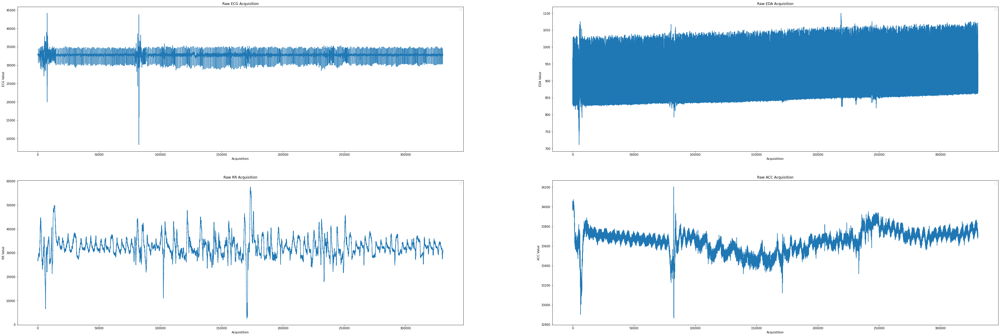

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

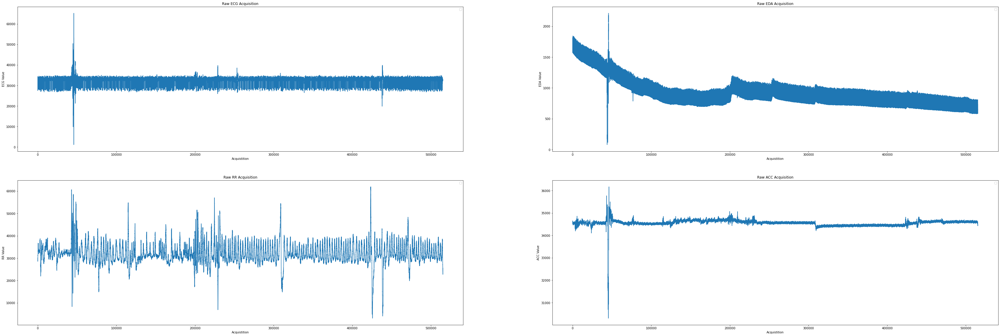

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

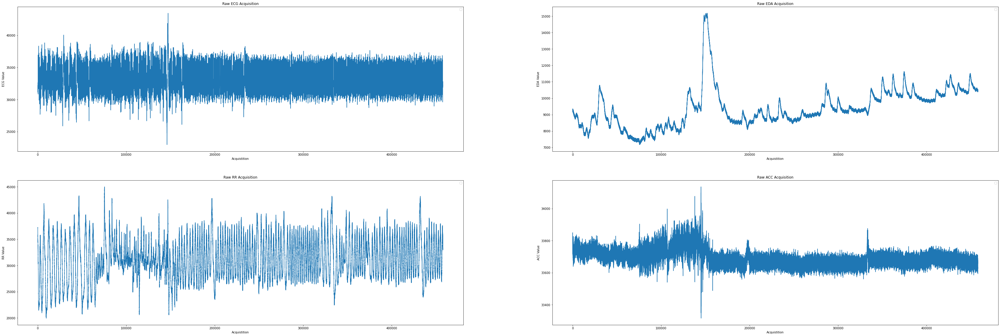

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

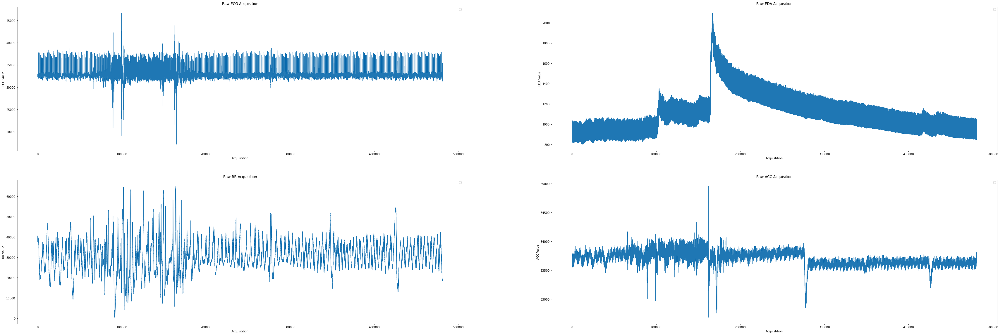

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

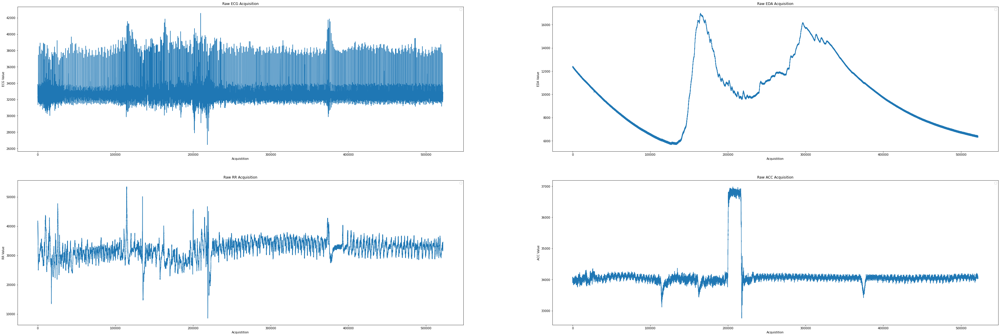

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

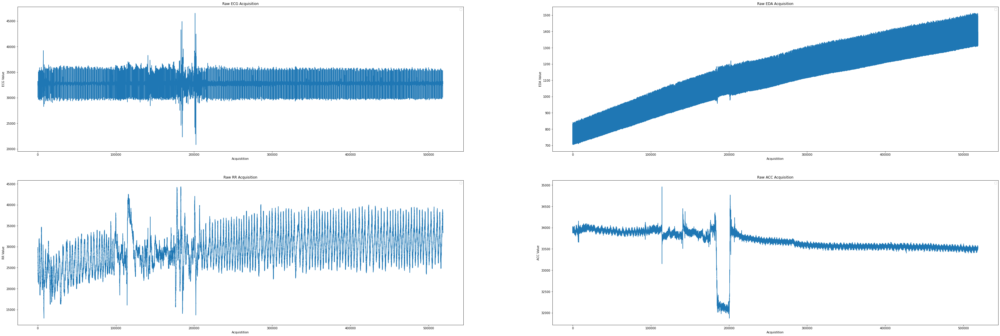

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

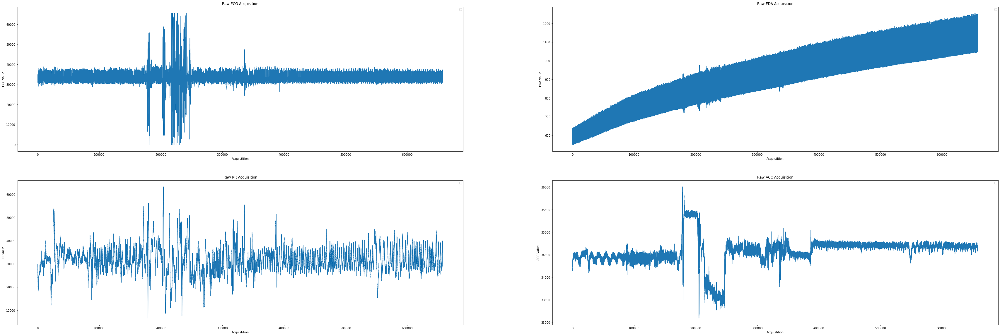

<Figure size 432x288 with 0 Axes>

In [81]:
import matplotlib.pyplot as plt

def collectData(i):
    data_ecg, data_eda, data_rr, data_acc = [], [],[],[]
    for j in range(len(Datasets)):
        data_ecg.append(Datasets[j]['channel_1'][:i])
        data_eda.append(Datasets[j]['channel_2'][:i])
        data_rr.append(Datasets[j]['channel_3'][:i])
        data_acc.append(Datasets[j]['channel_4'][:i])
    return [data_ecg, data_eda, data_rr, data_acc]

dataplot = collectData(-1)

def plotDatas():
    for j in range(len(Datasets)):
        i = 1
        label = ['ECG', 'EDA', 'RR', 'ACC']
        plt.figure(figsize=(60,20))
        for el in dataplot:
            plt.subplot(2,2,i)
            plt.plot(el[j])
            plt.title(f'Raw {label[i-1]} Acquisition')
            plt.xlabel('Acquistition')
            plt.ylabel(f'{label[i-1]} Value')
            plt.legend()
            i += 1
        plt.show()
        plt.savefig(f'rawdatas{j+1}.png')

plotDatas()